# Solution to IMO 2025 P2

In this notebook you can reproduce a solution to our formalization of problem 2 of the IMO 2025, the plane geometry one.

Aristotle solved the problem quickly by suggesting point ```w = circle w d e f```, separated by a ```|``` in the formalization string below. When you run the notebook, Newclid will solve the problem using the auxiliary point, and provide you with the proof, the controllable animation, and the ```.mp4``` animation of the proof.

It is important to mention that the proof generated depends on the rules that are available to the engine at the moment you run the notebook. So, as we kept working, the proof here will inevitably differ from the one released by Harmonic after the IMO.

## Formalization of the problem

The original statement of the problem was the following:

> Let $\Omega$ and $\Gamma$ be circles with centres $M$ and $N$ respectively, such that the radius of $\Omega$ is less than the radius of $\Gamma$. Suppose circles $\Omega$ and $\Gamma$ intersect at two distinct points $A$ and $B$. Line $MN$ intersects $\Omega$ at $C$ and $\Gamma$ at $D$, such that points $C$, $M$, $N$ and $D$ lie on the line in that order. Let $P$ be the circumcentre of triangle $ACD$. Line $AP$ intersects $\Omega$ again at $E\neq A$. Line $AP$ intersects $\Gamma$ again at $F\neq A$. Let $H$ be the orthocentre of triangle $PMN$.
>
>Prove that the line through $H$ parallel to $AP$ is tangent to the circumcircle of triangle $BEF$.
>
>(The *orthocentre* of a triangle is the point of intersection of its altitudes.)

This problem presents two main difficulties when being formalized into JGEX:

- How to force the order $C-M-N-D$ of points on the line?
- How to encode the tangency condition in the goal?

### Getting the points on a line

For the formalization, we start by creating points $A$, $M$, $N$, and $B$, leaving $C$ and $D$ to be constrained between two choices each (intersections of a line and  a circle). This roughly means that the good order will be achieved one in every four constructions, and we force the engine to choose the good one by adding the artificial goals ```obtuse_angle c m n``` (that imposes $M$ to be between $C$ and $N$), and ```obtuse_angle m n d``` (that imposes $M$ to be between $N$ and $D$).

This strategy works because given a JGEX string, Newclid will try to build a coordinate representation of the points using the sketch functions of the constructions, while also checking that the goals are satisfied. As the sketch functions have some degrees of freedom controlled by random generators, it tries a couple of times until getting a good one if needed. Adding numerically checked predicates as goals becomes a good way of imposing restrictions on the drawing, as they do not change the proof, in the sense that if a numerical check is true and needed for the proof, it would show up the same way, regardless of whether it is imposed as a goal or not.

### Establishing the goal

Newclid cannot make statements based on lines and circles, only points. That makes tangency goals less straightforward to represent, demanding some proxy condition. This can be seen in other formalizations of problems involving tangency that are public, both in AlphaGeometry's ```imo_ag_30.txt``` problem set and in ours ```imo.txt``` and ```imo_sl.txt```.

All formulations rely on creating the tangency point between line and circle (point ```x = on_dia x o h, on_pline x h a p``` below), with some properties of the tangency point (in this case, $OX$ is perpendicular to $XH$ and $X$ is on the line parallel to $AP$ through $H$), and put the other property as the goal ($X$ lies on the circle centered at $O$ through $B$).

In [1]:
import numpy as np
from IPython.display import HTML
from newclid.api import GeometricSolverBuilder
from newclid.jgex.problem_builder import JGEXProblemBuilder

rng = np.random.default_rng(0)

jgex_problem_builder = (
    JGEXProblemBuilder(rng=rng)
    .include_auxiliary_clauses()
    .with_problem_from_txt(
        "a m n = triangle a m n"
        "; b = on_circle b m a, on_circle b n a"
        "; c = on_line c m n, on_circle c m a"
        "; d = on_line d m n, on_circle d n a"
        "; p = circle p a c d"
        "; e = on_line e a p, on_circle e m a"
        "; f = on_line f a p, on_circle f n a"
        "; h = on_tline h p m n, on_tline h m p n"
        "; o = circle o b e f"
        "; x = on_dia x o h, on_pline x h a p"
        " | w = circle w d e f"
        " ? cong o x o b"
        "; obtuse_angle c m n"
        "; obtuse_angle m n d",
        problem_name="IMO 2025 P2",
    )
)
problem_setup = jgex_problem_builder.build()

solver = GeometricSolverBuilder(rng=rng).build(problem_setup)
solver.run()

assert solver.run_infos is not None
run_time = solver.run_infos.runtime
print(f"Success in {run_time:.2f}s" if solver.run_infos.success else "Failure")

Success in 1.84s


## Proof

By running the cell below, you'll get the full proof of the problem.

First, you see the coordinates of the points generated by Newclid from the JGEX string, then the codification of the assumptions that are used, given by the constructions themselves. That is the information Newclid has before running any type of reasoning.

Following that, Newclid will alternate between trying to apply rules and run an algebraic reasoning (AR) process to try to get new statements, until it gets to the proof. It will also regularly check if the goals have already been attained.

During this process, for somes rules, Newclid "looks at the drawing", that is, numerically checks some assumptions to verify that the configuration is not degenerate. As those are true from the beginning of the proof, we list them after the assumptions, but it should be mentioned that they will effectively be added as truths during the application of rules.

Finally, the problem setup ends with the list of goals as well as a reference of where they are proven. Notice that two goals are numerical checks only, so they don't show up in the body of the proof.

After the "Problem setup" we have the steps of the proof. You can see two types of steps:

- Rule applications: the use of a theorem (identified by its number ```rXX```, which statement can be found in the documentation).
- AR deductions: some statements will generate linear equations on segments of the problem, that can be stored in one of two linear systems - the angles table and the ratios table. Row-reduction of those systems will generate new equations that can be turned back into new statements to be fed into the logical engine.

Each step will list its premises, then tell what kind of step is being applied, and finally give its conclusion. It should hold by itself, in the sense that all information needed to verify that step is in the step itself.

Checking that rules are being correctly applied should be easy, as they have just a couple of hypothesis, but AR deductions are a lot more complicated. To address that issue, we add an Appendix after the proof with the AR deductions listed by step. There you can find which coefficients were used on each linear equation and follow the steps taken in the row reduction of the table.

In [2]:
natural_language_proof = solver.proof()
print(natural_language_proof)

# Problem setup:

## Points

- A(0.0393, -0.4234)
- B(0.3534, -1.4027)
- C(-0.1409, -1.0212)
- D(1.8589, -0.3798)
- E(0.9147, -0.9959)
- F(1.5483, -1.4103)
- H(0.9039, -0.8407)
- M(0.3831, -0.8531)
- N(0.9555, -0.6696)
- O(0.9494, -1.6345)
- P(0.9641, -1.0283)
- W(1.4775, -0.8269)
- X(1.2994, -1.0993)

## Assumptions:

[C0] : O is the circumcenter of the circle ●BEF
[C1] : W is the circumcenter of the circle ●DEF
[C2] : A, F, P are collinear
[C3] : A, E, P are collinear
[C4] : HX ∥ AP
[C5] : HX ⟂ OX
[C6] : BM = AM
[C7] : BN = AN
[C8] : CM = AM
[C9] : P is the circumcenter of the circle ●ACD
[C10] : AN = DN
[C11] : EM = AM
[C12] : AN = FN
[C13] : C, M, N are collinear
[C14] : D, M, N are collinear
[C15] : HM ⟂ NP
[C16] : HP ⟂ MN

## Numerical checks

[N0] : ▲EWX has the same orientation as ▲FXW
[N1] : ▲EOW has the same orientation as ▲FWO
[N2] : A ≠ F
[N3] : A ≠ P
[N4] : F ≠ P
[N5] : A ≠ E
[N6] : E ≠ P
[N7] : E ≠ F
[N8] : O ≠ W
[N9] : O ≠ X
[N10] : W ≠ X
[N11] : ▲ABM has the same orient

## Animation

The text of the proof is good as a registry of all the information used in the reasoning, and to be carefully examined and verified. But specially for the big role of AR steps, which can correspond to very large applications of ratio chasing and angle chasing reasonings, it is hard to understand what exactly is Newclid doing by just reading the textual proof.

As this software is meant to solve geometry problems, the natural way to address this issue is to create a visual representation of the proof. Newclid generates an animation of the proof, where each step generates a frame, and which can be manually followed step by step using the controller below.

The animation starts following the constructions offered to the solver, using green colors, then highlights in blue the auxiliary construction, and the goal in yellow. After the goal is shown, the proof starts in reddish-pink hues.

The animation makes the logic behind the proof a lot clearer. For example, it is easy to see how the circle recognized by Aristotle as an auxiliary construction completes a symmetric distribution of circles in the diagram.

Also, just by following the animation of the proof, one can see how a lot of it can be grouped into pieces where Aristotle is trying to prove a symmetry condition between triangles (including a self-similarity that corresponds to detecting an isosceles triangle). One can see that when many steps stick the same region of the diagram, typically the center of a circle, until it culminates in a triangle. Then the region moves around.

That happens because Newclid is accumulation information on angles and ratios, that will culminate in an AR deduction "flare". Those are a lot more powerful in adding statements connecting different regions of the diagram, hence their amplitude in the picture.

That angle/ratio collection steps occur mainly through triangle similarity, but you can see them happening when we have some concyclic quadrilaterals. This does not prevent the use of more sophisticated theorems as well, such as rule r74, that says that the intersection of a perpendicular bisector and an angle bisector on a triangle lies on its circumcircle.

On the other hand, the animation also gives a sense of how much time Newclid spends on "trivial steps", such as the multiple steps it takes "looking at a segment", while it turns collinear statements into parallelism ones, as well as when it detects that points on a circle are equidistant from the center. For a human, those are no-brainers, but it is important to recognize that they are part of the work that any rigorous formal proving system has to do in order to complete a problem that can be automatically verified.

Finally, at the very first steps we can see that the proof starts by collecting facts from the segments involved in the goal using the auxiliary point $W$. That confirms that $W$ plays a role in connecting the circle centered at $O$, which is the one involved in the goal, to the rest of the diagram.

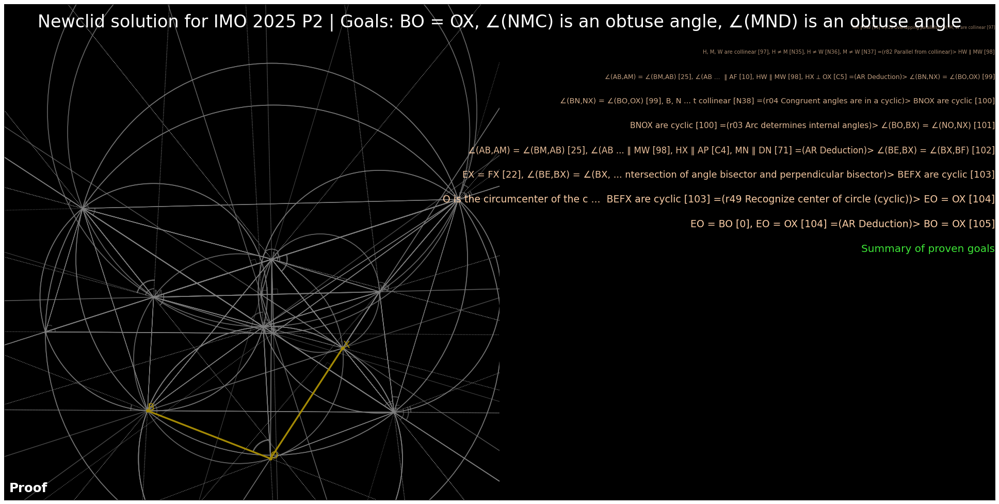

In [3]:
from newclid.animation import html_animation

assert jgex_problem_builder.jgex_problem is not None
HTML(html_animation(solver.animate(jgex_problem_builder.jgex_problem)))

## The animation file

Finally, you can turn the animation into a ```.mp4``` file that will run in high speed, which allows one to have a sense of the "flow" of the proof as Newclid changes its focus to the different sectors of the diagram, roughly delimited by the starting circles.

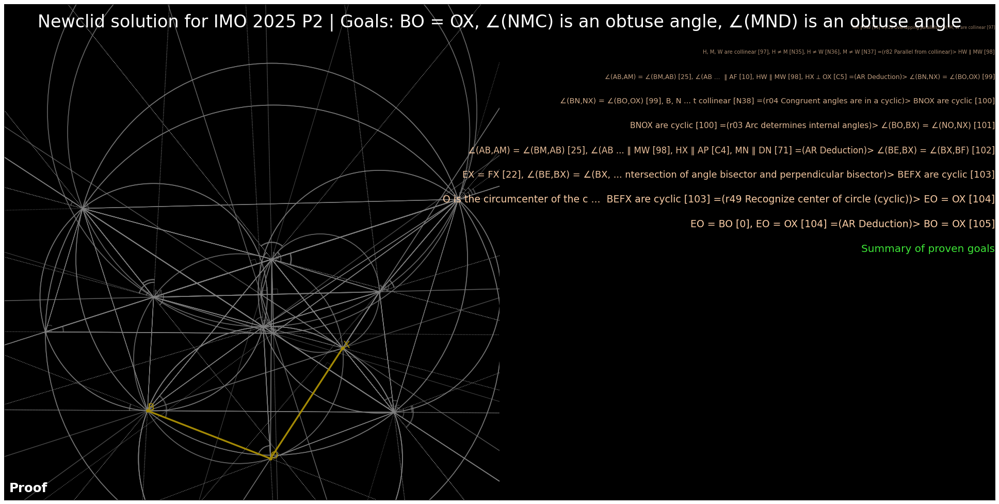

In [4]:
from matplotlib.animation import FFMpegWriter

assert jgex_problem_builder.jgex_problem is not None
FFwriter = FFMpegWriter(fps=6)
solver.animate(jgex_problem_builder.jgex_problem).save(
    "newclid_imo_2025.mp4", writer=FFwriter
)